# Importing

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/apple-watch-and-fitbit-data/data_for_weka_fb.csv
/kaggle/input/apple-watch-and-fitbit-data/aw_fb_data.csv
/kaggle/input/apple-watch-and-fitbit-data/data_for_weka_aw.csv


In [2]:
df=pd.read_csv('/kaggle/input/apple-watch-and-fitbit-data/aw_fb_data.csv')

In [3]:
df.head()

,Unnamed: 0,X1,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,device,activity
0,1,1,20,1,168.0,65.4,10.771429,78.531302,0.344533,0.008327,6.221612,6.116349,59.0,1.000000,19.531302,0.138520,1.000000,0.089692,apple watch,Lying
1,2,2,20,1,168.0,65.4,11.475325,78.453390,3.287625,0.008896,6.221612,6.116349,59.0,1.000000,19.453390,0.137967,1.000000,0.102088,apple watch,Lying
2,3,3,20,1,168.0,65.4,12.179221,78.540825,9.484000,0.009466,6.221612,6.116349,59.0,1.000000,19.540825,0.138587,1.000000,0.115287,apple watch,Lying
3,4,4,20,1,168.0,65.4,12.883117,78.628260,10.154556,0.010035,6.221612,6.116349,59.0,1.000000,19.628260,0.139208,1.000000,0.129286,apple watch,Lying
4,5,5,20,1,168.0,65.4,13.587013,78.715695,10.825111,0.010605,6.221612,6.116349,59.0,0.982816,19.715695,0.139828,0.241567,0.144088,apple watch,Lying


In [4]:
df=df.drop(['Unnamed: 0','X1'],axis=1)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6264 entries, 0 to 6263
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   age                   6264 non-null   int64  
 1   gender                6264 non-null   int64  
 2   height                6264 non-null   float64
 3   weight                6264 non-null   float64
 4   steps                 6264 non-null   float64
 5   hear_rate             6264 non-null   float64
 6   calories              6264 non-null   float64
 7   distance              6264 non-null   float64
 8   entropy_heart         6264 non-null   float64
 9   entropy_setps         6264 non-null   float64
 10  resting_heart         6264 non-null   float64
 11  corr_heart_steps      6264 non-null   float64
 12  norm_heart            6264 non-null   float64
 13  intensity_karvonen    6264 non-null   float64
 14  sd_norm_heart         6264 non-null   float64
 15  steps_times_distance 

In [6]:
df_aw=df[df['device']=='apple watch']
df_fb=df[df['device']=='fitbit']
df_aw=df_aw.drop('device',axis=1)
df_fb=df_fb.drop('device',axis=1)

In [7]:
pip install -U dataprep

     |████████████████████████████████| 3.7 MB 4.5 MB/s            
     |████████████████████████████████| 743 kB 69.0 MB/s            
     |████████████████████████████████| 1.0 MB 52.0 MB/s            
     |████████████████████████████████| 1.5 MB 57.6 MB/s            
     |████████████████████████████████| 943 kB 71.7 MB/s            
  Preparing metadata (setup.py) ... - done
     |████████████████████████████████| 110 kB 53.0 MB/s            
     |████████████████████████████████| 15.7 MB 29.4 MB/s            
     |████████████████████████████████| 49 kB 4.3 MB/s             
     |████████████████████████████████| 854 kB 56.2 MB/s            
  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13919 sha256=8e21714a04264984348041dce721149af414f30b976154a72b7c7f697ea2cf9f
  Stored in directory: /root/.cache/pip/wheels/1d/a8/cb/6f8902aa5457bd71344e00665c230e9c45255b3f57f2194a0f
Successfully built metaphone
  Attempting uninstall: numpy
    Found exist

In [8]:
!pip install pycaret[full]

     |████████████████████████████████| 301 kB 4.3 MB/s            
     |████████████████████████████████| 16.5 MB 45.0 MB/s            
     |████████████████████████████████| 114 kB 68.3 MB/s            
  Preparing metadata (setup.py) ... - done
     |████████████████████████████████| 6.8 MB 44.4 MB/s            
     |████████████████████████████████| 636 kB 62.3 MB/s            
     |████████████████████████████████| 24.2 MB 40.3 MB/s            
     |████████████████████████████████| 10.4 MB 40.6 MB/s            
     |████████████████████████████████| 25.9 MB 46.6 MB/s            
     |████████████████████████████████| 167 kB 37.8 MB/s            
     |████████████████████████████████| 73 kB 1.5 MB/s             
     |████████████████████████████████| 668 kB 38.7 MB/s            
     |████████████████████████████████| 305 kB 65.3 MB/s            
     |████████████████████████████████| 40 kB 3.0 MB/s             
     |████████████████████████████████| 59 kB 4.3 MB/s   

In [9]:
import plotly.graph_objects as go
import matplotlib.pyplot as plt

from dataprep.eda import *
from pycaret.classification import *

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

import warnings
warnings.filterwarnings("ignore")

import seaborn as sns

In [10]:
df_fb['activity'].value_counts()

Lying             592
Running 7 METs    501
Running 5 METs    399
Running 3 METs    378
Sitting           378
Self Pace walk    360
Name: activity, dtype: int64

# Apple Watch Analysis

1)6 physical activity types

In [11]:
labels = ['Lying','Running 7 METs','Running 5 METs','Running 3 METs', 'Sitting', 'Self Pace walk']
values = df_aw['activity'].value_counts()
colors = ['red', 'royalblue','green','yellow','pink','grey']
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.5)])
fig.update_traces(hoverinfo='label+value',textfont_size=15,marker=dict(colors=colors))
fig.update_layout(annotations=[dict(text='AW 6 types of Activity', 
                                    x=0.50, y=0.5, font_size=15, 
                                    showarrow=False)])
fig.show()

2)Apple Watch Plotting

  0%|          | 0/1241 [00:00<?, ?it/s]


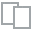
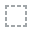
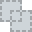
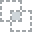
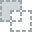
...
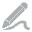
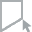
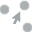
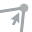
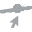

In [12]:
plot(df_aw)

3)Apple Watch Pairplot

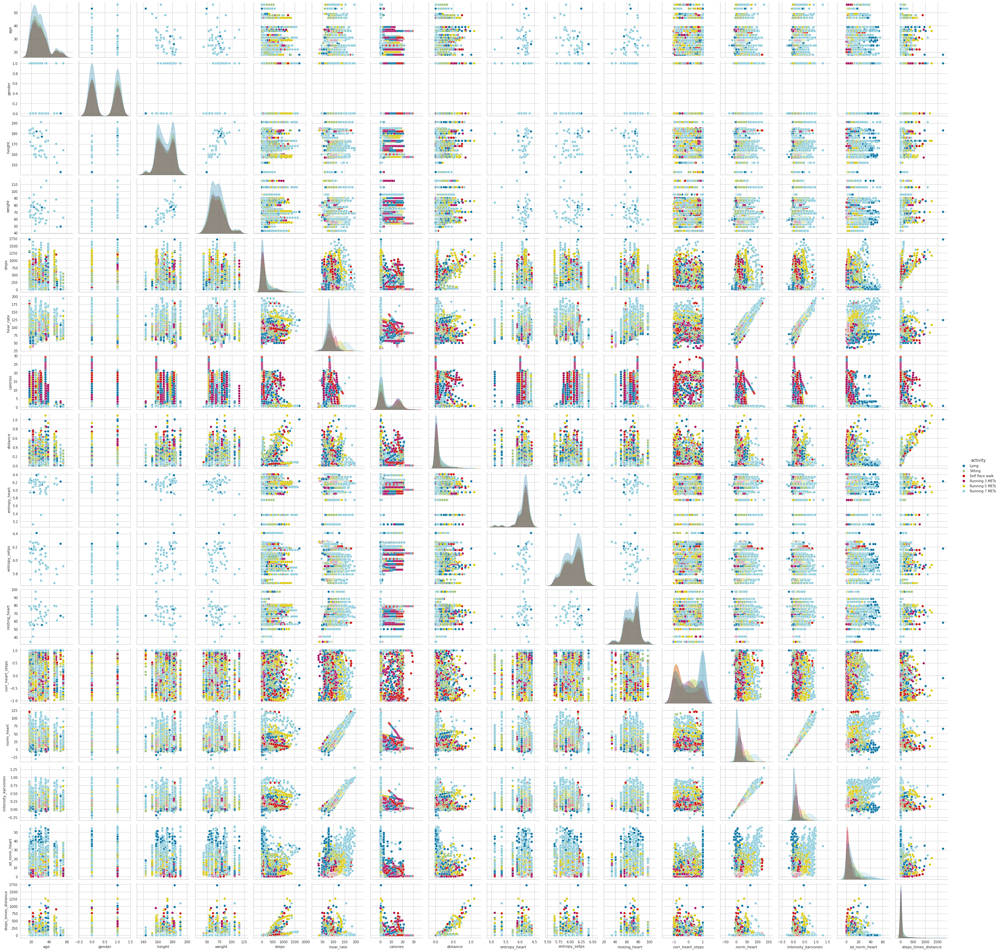

In [13]:
sns.pairplot(df_aw,hue='activity')

4)Apple Watch Correlation Heatmap

<AxesSubplot:>

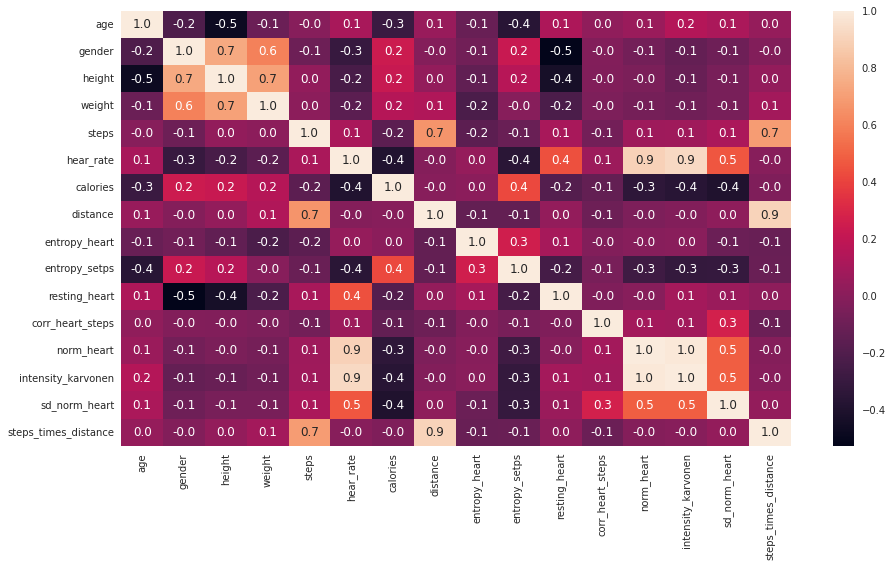

In [14]:
plt.figure(figsize = (15,8))
sns.heatmap(df_aw.corr(),annot=True,fmt='.1f')

5)Apple Watch Activity Prediction Model

In [15]:
df_train, df_test = train_test_split(df_aw, random_state =100 , test_size = 0.3)

In [16]:
setup_df = setup(data= df_train, target = 'activity', 
                session_id=100, data_split_stratify=True, 
                 silent=True, remove_outliers=True)

,Description,Value
0,session_id,100
1,Target,activity
2,Target Type,Multiclass
3,Label Encoded,"Lying: 0, Running 3 METs: 1, Running 5 METs: 2, Running 7 METs: 3, Self Pace walk: 4, Sitting: 5"
4,Original Data,"(2559, 17)"
5,Missing Values,False
6,Numeric Features,15
7,Categorical Features,1
8,Ordinal Features,False
9,High Cardinality Features,False


In [17]:
#top3_models = compare_models(n_select=3)
#top3_models

In [18]:
lgbm = create_model("lightgbm")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7310,0.9327,0.7412,0.7280,0.7253,0.6771,0.6788
1,0.7471,0.9374,0.7491,0.7557,0.7486,0.6951,0.6960
2,0.7882,0.9438,0.7976,0.7851,0.7859,0.7454,0.7458
3,0.7353,0.9357,0.7443,0.7326,0.7304,0.6818,0.6831
4,0.7882,0.9618,0.7903,0.7898,0.7857,0.7447,0.7460
5,0.7706,0.9553,0.7734,0.7691,0.7687,0.7240,0.7244
6,0.8471,0.9646,0.8512,0.8462,0.8456,0.8159,0.8163
7,0.8235,0.9698,0.8256,0.8238,0.8228,0.7873,0.7876
8,0.7471,0.9428,0.7436,0.7555,0.7481,0.6945,0.6961
9,0.7882,0.9648,0.7859,0.7965,0.7888,0.7448,0.7461


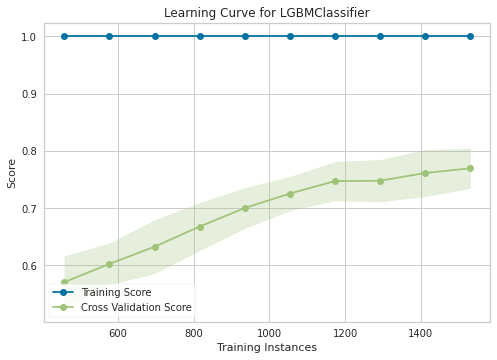

In [19]:
plot_model(estimator = lgbm , plot= "learning")

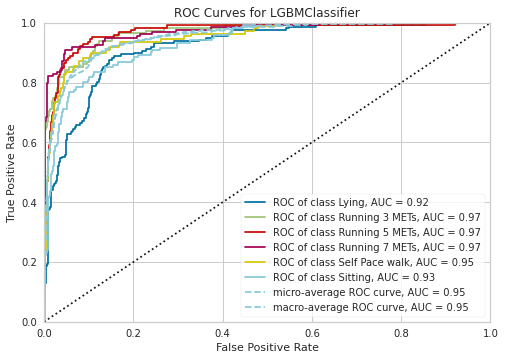

In [20]:
plot_model(estimator = lgbm , plot= "auc")

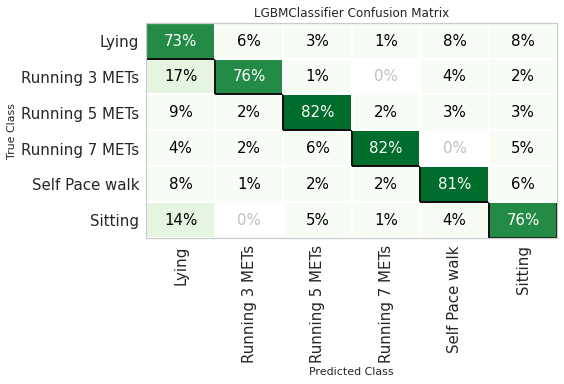

In [21]:
plot_model(estimator = lgbm, plot= "confusion_matrix", plot_kwargs = {'percent' : True})

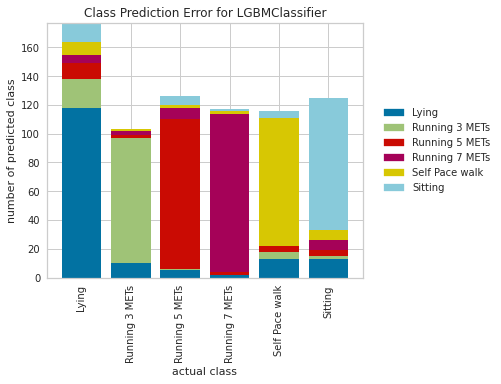

In [22]:
plot_model(estimator = lgbm, plot = "error")

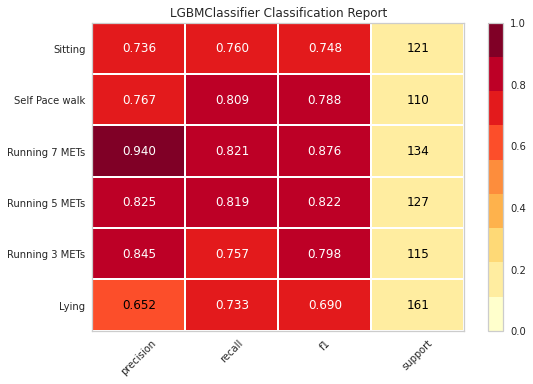

In [23]:
plot_model(estimator = lgbm, plot = "class_report")

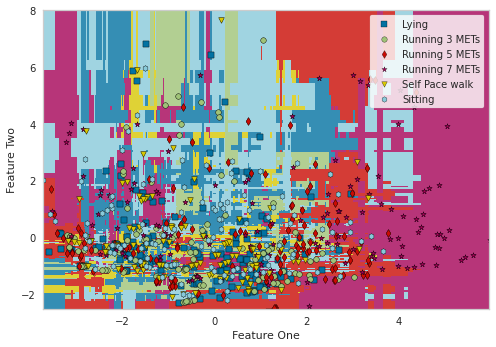

In [24]:
plot_model(estimator = lgbm, plot = "boundary")

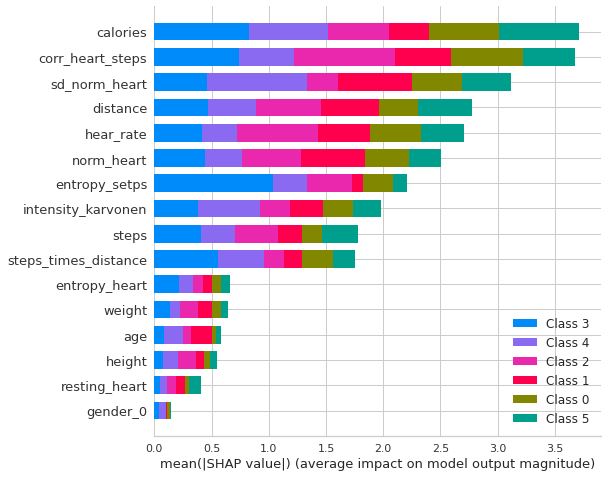

In [25]:
interpret_model(lgbm)

In [26]:
predict_model(lgbm);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.7812,0.9516,0.7831,0.7895,0.7837,0.7363,0.7370


In [27]:
pred = predict_model(lgbm, data=df_test)
pred.head()

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,activity,Label,Score
2488,56,1,164.0,62.0,57.131313,65.000000,0.287333,0.032524,5.745907,5.909440,65.000000,-0.384876,0.000000,0.000000,1.615055,1.858127,Lying,Lying,0.5679
423,23,1,181.0,95.2,493.285714,54.777778,19.721733,0.325575,6.259761,6.259761,56.333333,-0.085329,-1.555556,-0.011058,1.923440,160.601426,Sitting,Sitting,0.9862
1311,36,0,157.5,53.6,12.551724,83.819209,24.278138,0.006387,6.008680,6.103885,78.823447,1.000000,4.995763,0.047499,0.560201,0.080167,Running 3 METs,Running 3 METs,0.7189
2416,30,1,182.0,80.0,177.000000,72.000000,9.676800,0.115690,5.913763,5.941932,69.600000,0.198053,2.400000,0.019934,9.399911,20.477130,Lying,Lying,0.9949
2862,25,0,160.0,57.7,857.750000,109.333333,0.756000,0.030995,6.142147,6.020552,78.531302,0.528794,30.802031,0.264466,4.203851,26.585961,Running 3 METs,Running 3 METs,0.9912


In [28]:
accuracy_score(pred['activity'], pred['Label'])

0.7666362807657247

# Fitbit Analysis

1)6 physical activity types

In [29]:
labels = ['Lying','Running 7 METs','Running 5 METs','Running 3 METs', 'Sitting', 'Self Pace walk']
values = df_fb['activity'].value_counts()
colors = ['red', 'royalblue','green','yellow','pink','grey']
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.5)])
fig.update_traces(hoverinfo='label+value',textfont_size=15,marker=dict(colors=colors))
fig.update_layout(annotations=[dict(text='FB 6 types of Activity', 
                                    x=0.50, y=0.5, font_size=15, 
                                    showarrow=False)])
fig.show()

2)Fitbit Plotting

  0%|          | 0/1241 [00:00<?, ?it/s]


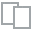
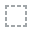
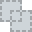
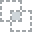
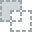
...
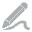
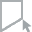
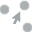
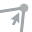
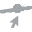

In [30]:
plot(df_fb)

3)Fitbit Pairplot

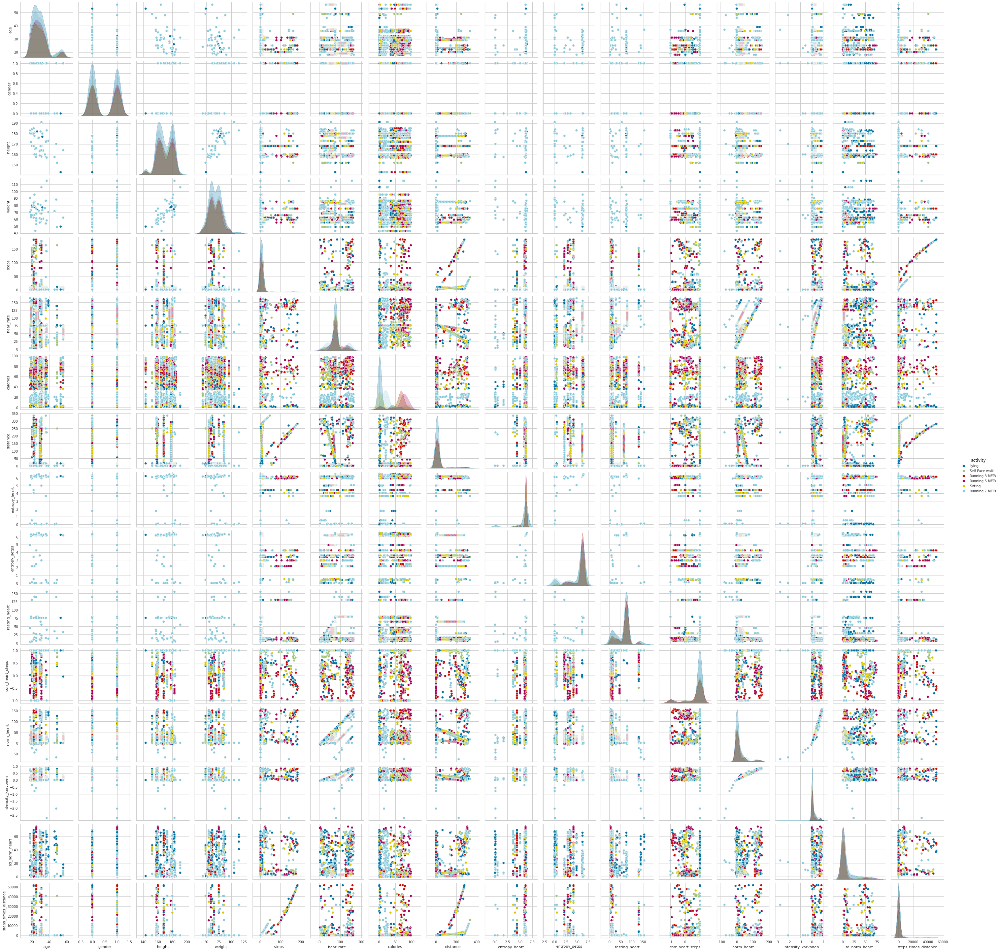

In [31]:
sns.pairplot(df_fb,hue='activity')

4)Fitbit Correlation Heatmap

<AxesSubplot:>

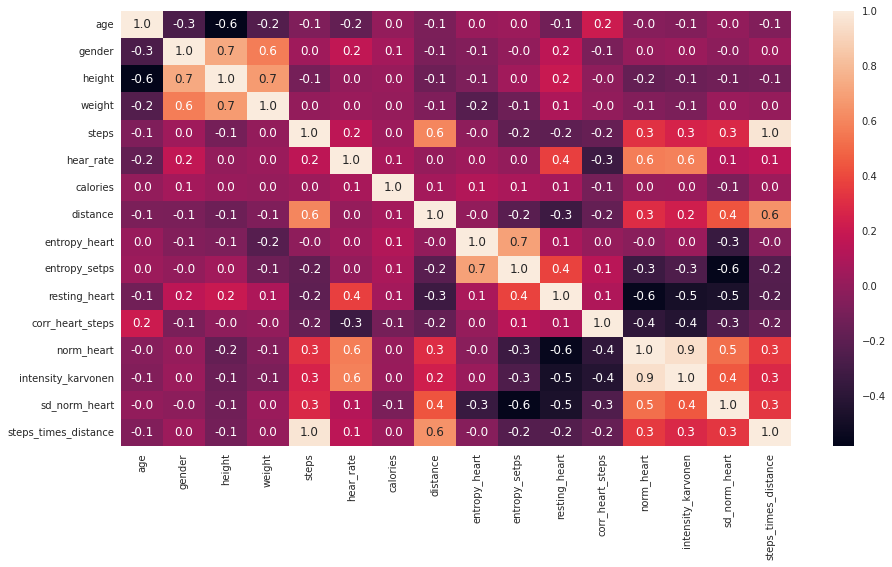

In [32]:
plt.figure(figsize = (15,8))
sns.heatmap(df_fb.corr(),annot=True,fmt='.1f')

5)Fitbit Activity Prediction Model

In [33]:
df_train2, df_test2 = train_test_split(df_fb, random_state =100 , test_size = 0.3)

In [34]:
setup_df2 = setup(data= df_train2, target = 'activity', 
                session_id=100, data_split_stratify=True, 
                 silent=True, remove_outliers=True)

,Description,Value
0,session_id,100
1,Target,activity
2,Target Type,Multiclass
3,Label Encoded,"Lying: 0, Running 3 METs: 1, Running 5 METs: 2, Running 7 METs: 3, Self Pace walk: 4, Sitting: 5"
4,Original Data,"(1825, 17)"
5,Missing Values,False
6,Numeric Features,15
7,Categorical Features,1
8,Ordinal Features,False
9,High Cardinality Features,False


In [35]:
lgbm2 = create_model("lightgbm")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8852,0.9866,0.8950,0.8870,0.8832,0.8618,0.8631
1,0.8033,0.9750,0.8109,0.8103,0.8022,0.7633,0.7652
2,0.8934,0.9870,0.8836,0.9013,0.8893,0.8710,0.8733
3,0.8926,0.9801,0.8940,0.8963,0.8924,0.8704,0.8712
4,0.8347,0.9743,0.8338,0.8380,0.8357,0.8004,0.8007
5,0.9091,0.9734,0.9080,0.9125,0.9089,0.8901,0.8909
6,0.8843,0.9835,0.8759,0.8852,0.8839,0.8599,0.8603
7,0.9008,0.9824,0.9026,0.9009,0.8996,0.8803,0.8808
8,0.8843,0.9894,0.8835,0.8949,0.8859,0.8606,0.8620
9,0.8926,0.9859,0.8841,0.8963,0.8923,0.8698,0.8708


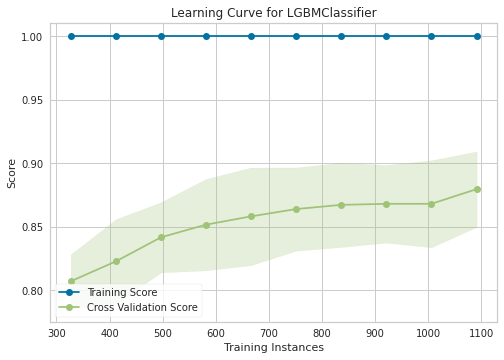

In [36]:
plot_model(estimator = lgbm2 , plot= "learning")

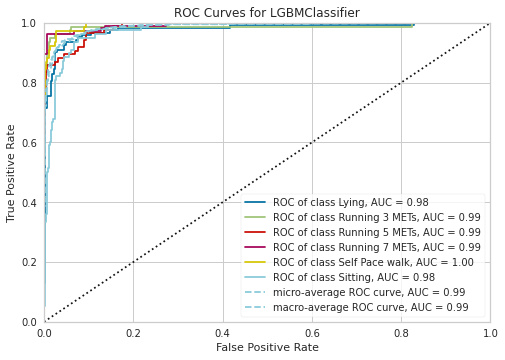

In [37]:
plot_model(estimator = lgbm2 , plot= "auc")

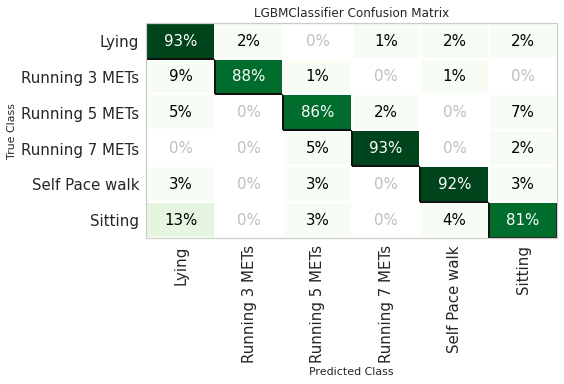

In [38]:
plot_model(estimator = lgbm2, plot= "confusion_matrix", plot_kwargs = {'percent' : True})

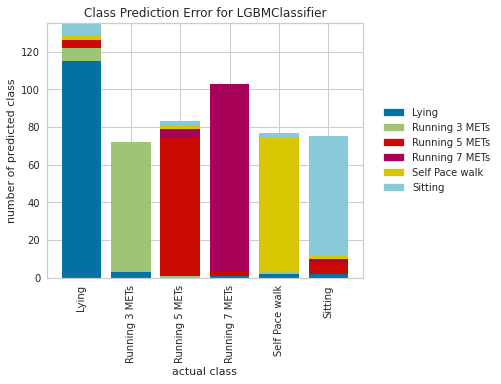

In [39]:
plot_model(estimator = lgbm2, plot = "error")

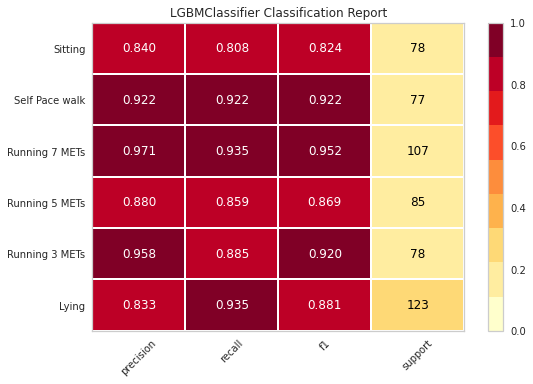

In [40]:
plot_model(estimator = lgbm2, plot = "class_report")

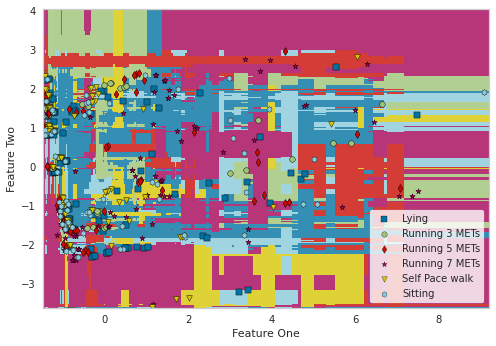

In [41]:
plot_model(estimator = lgbm2, plot = "boundary")

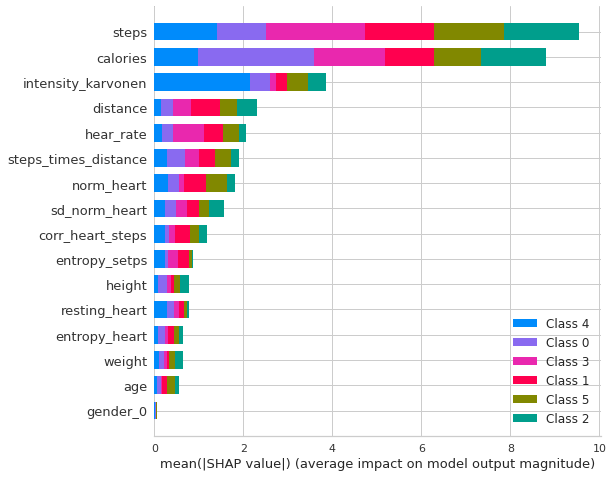

In [42]:
interpret_model(lgbm2)

In [43]:
predict_model(lgbm2);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8960,0.9861,0.8905,0.8986,0.8963,0.8740,0.8745


In [44]:
pred2 = predict_model(lgbm2, data=df_test2)
pred2.head()

,age,gender,height,weight,steps,hear_rate,calories,distance,entropy_heart,entropy_setps,resting_heart,corr_heart_steps,norm_heart,intensity_karvonen,sd_norm_heart,steps_times_distance,activity,Label,Score
4440,22,1,185.0,79.4,4.602871,76.241453,68.0,15.751196,6.285402,6.285402,75.667011,1.000000,0.574441,0.004696,0.069568,72.500721,Running 5 METs,Running 5 METs,1.0000
3773,30,0,164.0,68.0,3.593985,76.053036,77.0,15.762406,6.149747,6.149747,75.673905,1.000000,0.379131,0.003316,0.076525,56.649850,Sitting,Running 5 METs,0.9810
3824,24,0,165.0,43.0,6.421053,76.581011,69.0,15.730994,6.189825,6.189825,75.671798,1.000000,0.909213,0.007556,0.074399,101.009541,Running 3 METs,Running 3 METs,1.0000
6152,36,0,172.0,86.4,6.131579,76.526950,77.0,15.734211,6.339850,6.339850,75.686542,1.000000,0.840408,0.007759,0.066959,96.475554,Running 3 METs,Running 3 METs,0.9985
4792,25,1,160.0,75.0,161.000000,147.125000,71.0,248.000000,6.162890,4.232097,6.125000,0.948421,141.000000,0.746525,9.224307,39928.000000,Self Pace walk,Running 5 METs,0.4743


In [45]:
accuracy_score(pred2['activity'], pred2['Label'])

0.8773946360153256

By using LGBM, I can predict types of activity with Apple Watch with accuracy 76.6% and I can also predict them with Fitbit with accuracy 87,7%